# 02 - Exploratory Analysis and Preliminary Model Results

In [39]:
# data processing
import pandas as pd
import numpy as np
import scipy.stats as sp
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import fbeta_score, make_scorer

# data visualization
import seaborn as sns
import matplotlib.pyplot as plt
plt.style.use('seaborn')

# model processing
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier

# other tools
from utils import dataframe_utils, preprocess_utils, feature_importance_utils, model_utils, preprocess_utils
from utils.estimator_wrapper import *

from joblib import dump, load


### Importing and pre-visualization

In [2]:
df_covid = pd.read_csv('datasets/dataset_preprocessed.csv')
df_covid

,Patient age quantile,SARS-Cov-2 exam result,Hematocrit,Hemoglobin,Platelets,Mean platelet volume,Red blood Cells,Lymphocytes,Mean corpuscular hemoglobin concentration (MCHC),Leukocytes,...,CoronavirusNL63,Rhinovirus/Enterovirus,Coronavirus HKU1,Parainfluenza 3,Adenovirus,Parainfluenza 4,Coronavirus229E,CoronavirusOC43,Inf A H1N1 2009,Metapneumovirus
0,17,0,0.236515,-0.022340,-0.517413,0.010677,0.102004,0.318366,-0.950790,-0.094610,...,0,1,0,0,0,0,0,0,0,0
1,1,0,-1.571682,-0.774212,1.429667,-1.672222,-0.850035,-0.005738,3.331071,0.364550,...,0,0,0,0,0,0,0,0,0,0
2,9,0,-0.747693,-0.586244,-0.429480,-0.213711,-1.361315,-1.114514,0.542882,-0.884923,...,0,0,0,0,0,0,0,0,1,0
3,11,0,0.991838,0.792188,0.072992,-0.550290,0.542763,0.045436,-0.452899,-0.211488,...,0,1,0,0,0,0,0,0,0,0
4,13,0,1.014726,0.854844,-0.178244,0.796029,0.489872,-0.730707,-0.353319,-0.075131,...,0,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
357,18,1,1.197836,1.356092,-1.911774,1.132609,0.384090,0.966573,0.841616,-0.834833,...,0,0,0,0,0,0,0,0,0,0
358,19,0,0.190738,0.165628,-0.102873,0.908221,0.384090,-1.583611,-0.054585,-0.328365,...,0,0,0,0,0,0,0,0,0,0
359,19,0,-0.289922,-0.523588,0.663397,-0.774677,0.754327,-1.532437,-1.050367,1.569499,...,0,0,0,0,0,0,0,0,0,0
360,15,0,0.717175,1.105468,-0.492289,-0.213711,0.613284,0.002791,1.538664,-0.550988,...,0,0,0,0,0,0,0,0,0,0


### Visualizing categorical data values

In [3]:
def plot_binary_class_variable_distribution(df, columns, title, class_label, classes_values = [0,1], n_columns = 4, n_rows = 10,figsize=(20, 30)):

    fig, axes = plt.subplots(n_rows,n_columns,figsize=figsize)
    fig.suptitle(title,fontsize = 20)
    
    for index,col in enumerate(columns):

        keys = df[col].value_counts().keys()
        if n_rows == 1 or n_columns == 1:
            current_ax = axes[index]
        else:
            row_index = int(index / n_columns)
            col_index = int(index - n_columns * row_index)
            current_ax = axes[row_index][col_index]

        positive = df.copy()[df[class_label] == classes_values[0]][col]
        positive = positive.value_counts()
        negative = df.copy()[df[class_label] == classes_values[1]][col]
        negative = negative.value_counts()
        ax = pd.DataFrame({str(classes_values[0]): positive, str(classes_values[1]): negative}).plot(kind='bar', stacked=True,ax = current_ax)
        ax.set_xticklabels(keys)
        ax.set_title(col)
    plt.subplots_adjust(top=0.92, bottom=0, left=0.10, right=0.95, hspace=0.40,
                    wspace=0.35)
    plt.show()


def plot_numerical_distributions(df,columns,title, n_rows = 4, n_columns = 4, figure_size = (20, 12)):
    if (n_rows * n_columns) < len(columns):
        raise Exception('Columns must be the equal or smaller than the number of rows and columns.')
    fig, axes = plt.subplots(n_rows, n_columns, figsize = figure_size)
    fig.suptitle(title,fontsize = 20)
    
    for index,col in enumerate(columns):
        
        if n_rows == 1 or n_columns == 1:
            current_ax = axes[index]
        else:
            row_index = int(index/n_columns)
            col_index = int(index - n_columns*row_index)
            current_ax = axes[row_index][col_index]

        
        ax = sns.distplot(df[col], norm_hist=False,ax = current_ax,kde = False) 
        ax.set_title(col)
        label = r'$\mu={:2.2f},\ \sigma={:2.2f},\ median={:2.2f},\ mode={:2.2f}$'.format(df[col].mean(),df[col].std(),df[col].median(),df[col].mode().values[0])
        ax.set_xlabel(label)
    plt.subplots_adjust(top=0.92,hspace = 0.45,wspace = 0.5)    
    plt.show()
    
def plot_numerical_correlation(df,title,class_label):
    scatter_matrix = sns.pairplot(df,hue=class_label,height = 4);
    scatter_matrix.fig.suptitle('Correlation Between Numerical Variables',fontsize = 20);
    plt.subplots_adjust(top=0.95)

In [4]:
categorical_columns = []
for col in df_covid.columns:
    if df_covid[col].unique().shape[0] <= 2:
        categorical_columns.append(col)
unique_values = dataframe_utils.get_column_categories(df_covid[categorical_columns])

numeric_columns = np.setdiff1d(df_covid.columns,categorical_columns)
class_label = 'SARS-Cov-2 exam result'

Column Values:
SARS-Cov-2 exam result : [0 1]
Respiratory Syncytial Virus : [0 1]
Influenza A : [0 1]
Influenza B : [0 1]
CoronavirusNL63 : [0 1]
Rhinovirus/Enterovirus : [1 0]
Coronavirus HKU1 : [0 1]
Parainfluenza 3 : [0 1]
Adenovirus : [0 1]
Parainfluenza 4 : [0 1]
Coronavirus229E : [0 1]
CoronavirusOC43 : [0 1]
Inf A H1N1 2009 : [0 1]
Metapneumovirus : [0 1]


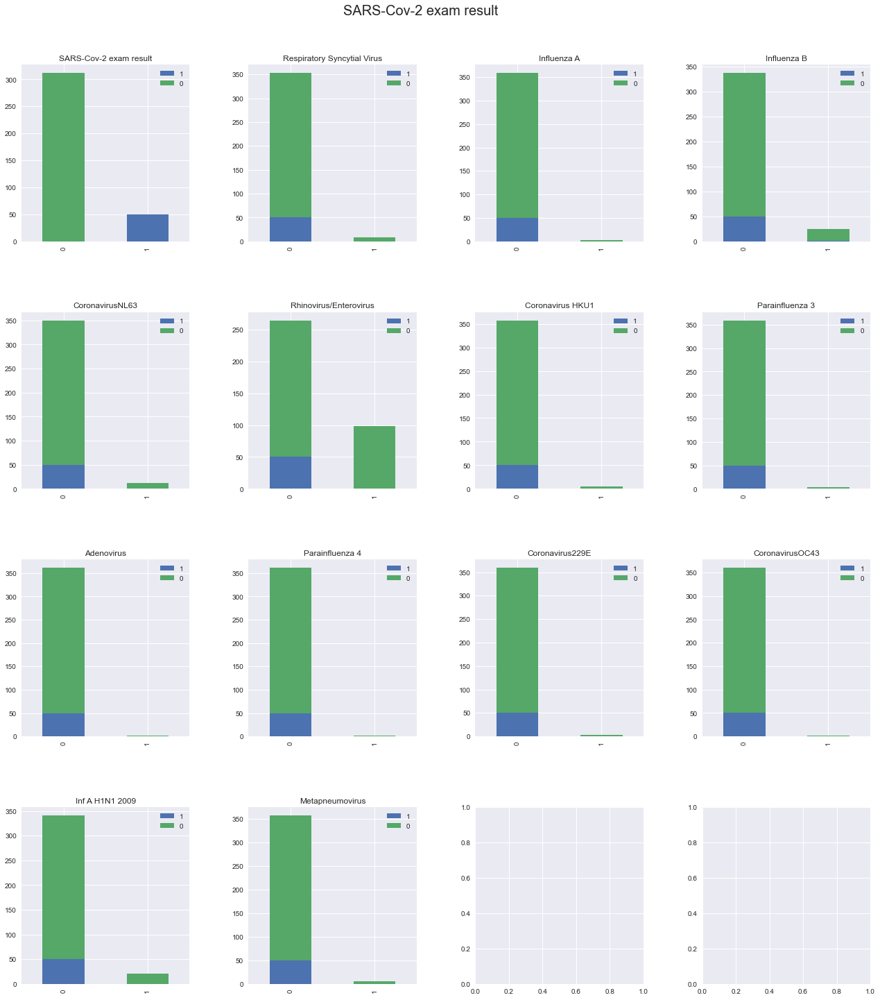

In [32]:
plot_binary_class_variable_distribution(df_covid, columns = categorical_columns, class_label = class_label, title = class_label , classes_values = [1,0], n_columns = 4, n_rows = 4,figsize=(20, 20))

Most features are unbalanced

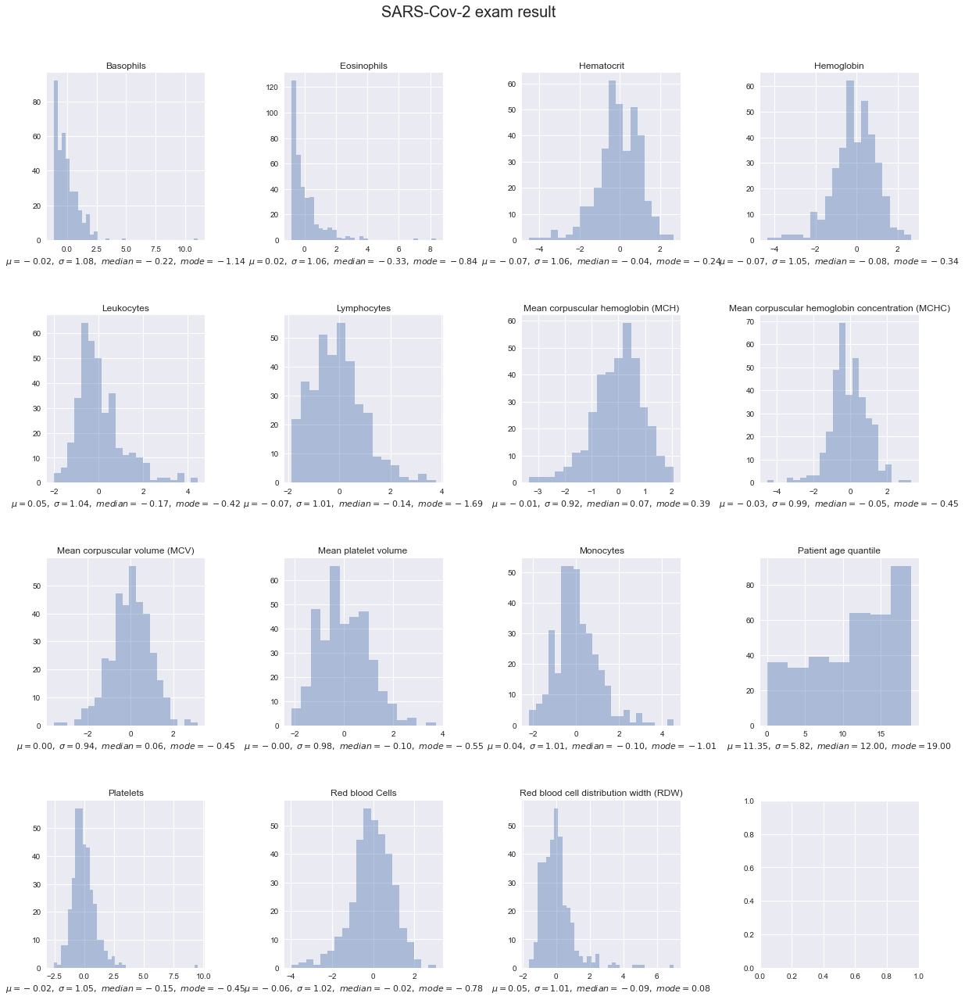

In [33]:
plot_numerical_distributions(df_covid,columns = numeric_columns,title = class_label, n_columns = 4, n_rows = 4, figure_size = (20, 20))

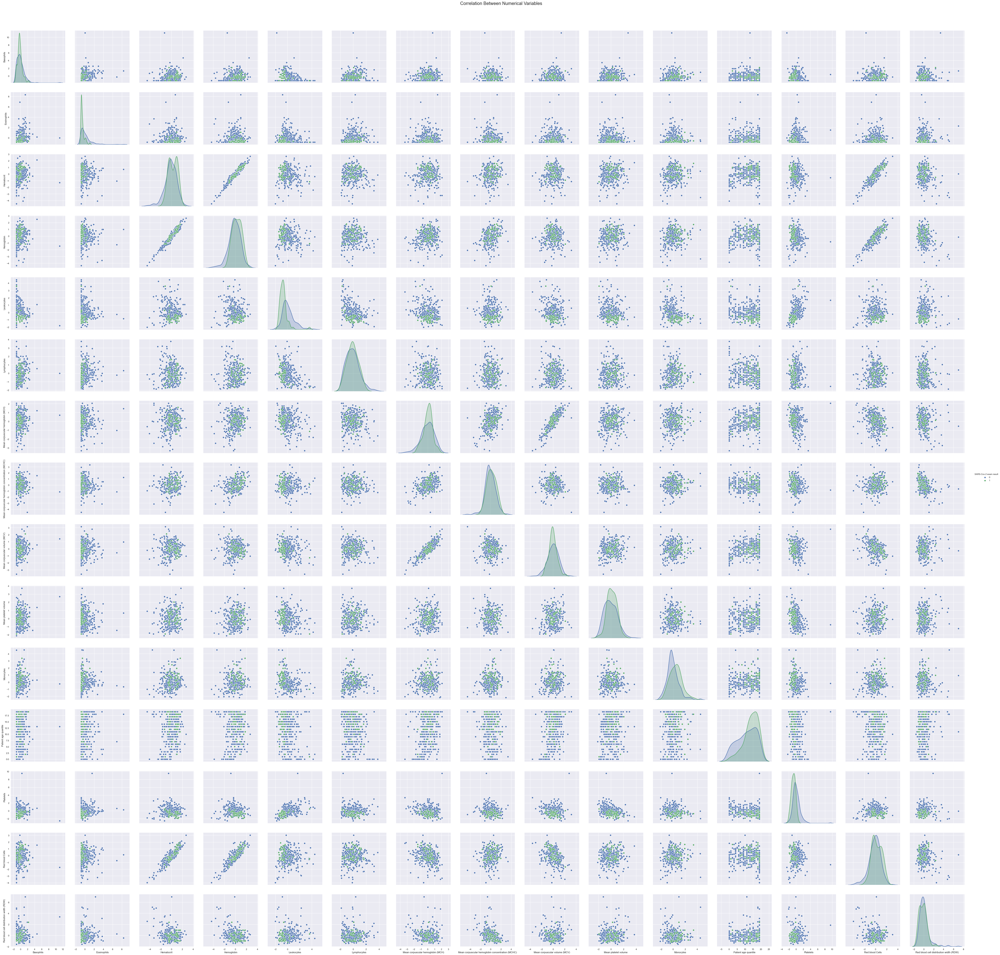

In [34]:
plot_numerical_correlation(df_covid[list(numeric_columns) + [class_label]],title = class_label,class_label = class_label)

## Traing and Testing Models

Let us try the following models:

- Random Forest
- Support Vector Machine
- Logistic Regression

Scoring function will be F2, since it is more costly to have false negatives than false positives

### Train and Test preparation

In [5]:
columns_x = df_covid.drop(columns = ['SARS-Cov-2 exam result']).columns
column_y = [class_label]

X_train, X_test, y_train, y_test = train_test_split(
    df_covid[columns_x], df_covid[column_y],  test_size=0.30, random_state=42)

scaler = MinMaxScaler()
scaler.fit(df_covid[columns_x])
dump(scaler, 'saves/minmax_scaler_no_imputation.bin', compress=True)

X_train_norm = pd.DataFrame(data=scaler.transform(X_train),columns=X_train.columns)
X_test_norm = pd.DataFrame(data=scaler.transform(X_test),columns=X_train.columns)

In [6]:
f2_scorer = make_scorer(fbeta_score, beta=2)

### Logistic Regression

In [13]:
logistic_regression_params = {
    'C' : [0.1,1,10,100],
    'penalty' : ['l2', 'elasticnet'],
    'solver' : ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'],
    'class_weight':[None,'balanced']
}

best_lr,best_lr_params,best_lr_score = model_utils.model_fit_with_grid_search_cv(
    LogisticRegression(),
    logistic_regression_params,
    X_train_norm.values,
    y_train.values.ravel(),
    folds = 5,
    score = f2_scorer,
    verbose = 1)

Fitting 5 folds for each of 80 candidates, totalling 400 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  56 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 385 out of 400 | elapsed:    1.1s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done 400 out of 400 | elapsed:    1.3s finished
--- Ellapsed time: 1.4325714111328125 seconds ---
Best params:  {'C': 100, 'class_weight': 'balanced', 'penalty': 'l2', 'solver': 'saga'}
Best score (make_scorer(fbeta_score, beta=2)) 0.7828858463726884



Performance Report: 
Accuracy: 0.872
Recall: 0.879
Precision: 0.773
F1: 0.807
F2: 0.844



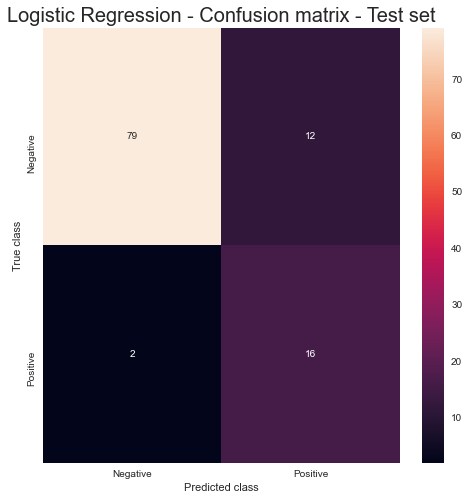

No Skill: ROC AUC=0.500
Logistic Regression : ROC AUC=0.900


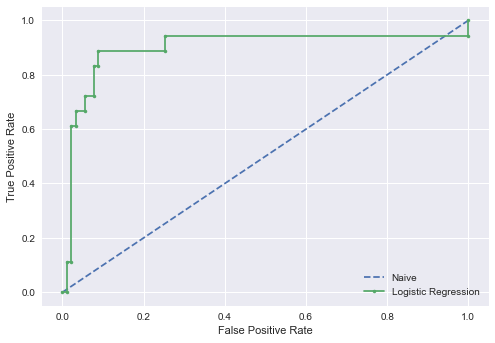

In [14]:
model_utils.evalute_model_performance(best_lr, 'Logistic Regression',X_test_norm,y_test)
# dump(best_lr, 'saves/logistic_regression_no_imputation.bin', compress=True)

### Random Forest

In [17]:
random_forest_params = {
    'n_estimators' : [10,20,50,100],
    'min_samples_split': [4,5,10],
    'max_depth':[5,8,10,13],
    'criterion':['gini','entropy'],
    'oob_score':[True],
    'class_weight':[None,'balanced']
}

best_random_forest,best_random_forest_params,best_random_forest_score = model_utils.model_fit_with_grid_search_cv(
    RandomForestClassifier(),
    random_forest_params,
    X_train_norm.values,
    y_train.values.ravel(),
    folds = 5,
    score = f2_scorer,
    verbose = 1)

Fitting 5 folds for each of 192 candidates, totalling 960 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    7.9s
[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed:   16.7s
[Parallel(n_jobs=-1)]: Done 434 tasks      | elapsed:   29.8s
[Parallel(n_jobs=-1)]: Done 784 tasks      | elapsed:   49.2s
[Parallel(n_jobs=-1)]: Done 960 out of 960 | elapsed:   59.4s finished
--- Ellapsed time: 59.897730350494385 seconds ---
Best params:  {'class_weight': 'balanced', 'criterion': 'entropy', 'max_depth': 5, 'min_samples_split': 5, 'n_estimators': 50, 'oob_score': True}
Best score (make_scorer(fbeta_score, beta=2)) 0.6718614718614719



Performance Report: 
Accuracy: 0.945
Recall: 0.856
Precision: 0.938
F1: 0.890
F2: 0.868



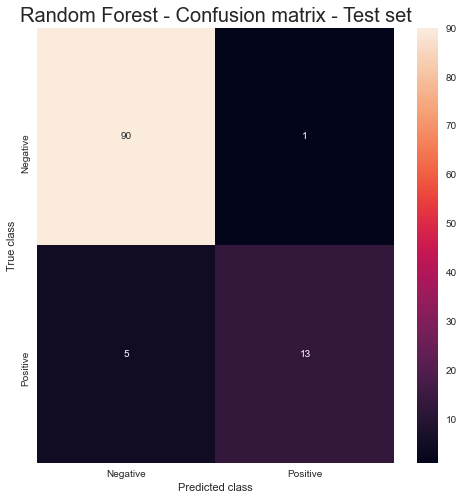

No Skill: ROC AUC=0.500
Random Forest : ROC AUC=0.904


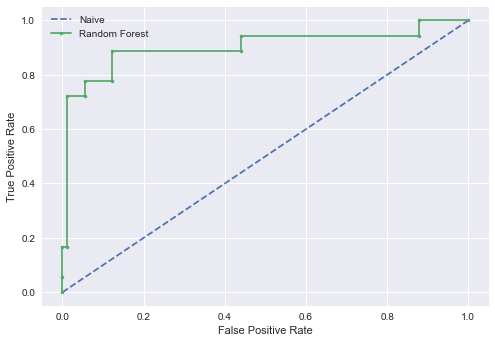

In [18]:
model_utils.evalute_model_performance(best_random_forest, 'Random Forest',X_test_norm,y_test)

### SVM

In [24]:
svm_params = {
    'C' : [0.1,0.5,1,10,20,50,100],
    'kernel': ['linear', 'poly', 'rbf', 'sigmoid'],
    'degree':[2,3,4],
    'coef0':[0,1,5,7,10],
    'class_weight':[None,'balanced']
}

best_svm,best_svm_params,best_svm_score = model_utils.model_fit_with_grid_search_cv(
    SVC(probability = True),
    svm_params,
    X_train_norm.values,
    y_train.values.ravel(),
    folds = 5,
    score = f2_scorer,
    verbose = 1)

Fitting 5 folds for each of 840 candidates, totalling 4200 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  56 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1200 tasks      | elapsed:    6.4s
[Parallel(n_jobs=-1)]: Done 3200 tasks      | elapsed:   16.5s
[Parallel(n_jobs=-1)]: Done 4200 out of 4200 | elapsed:   22.5s finished
--- Ellapsed time: 22.76338529586792 seconds ---
Best params:  {'C': 50, 'class_weight': 'balanced', 'coef0': 10, 'degree': 3, 'kernel': 'poly'}
Best score (make_scorer(fbeta_score, beta=2)) 0.7956187259592833



Performance Report: 
Accuracy: 0.881
Recall: 0.706
Precision: 0.813
F1: 0.741
F2: 0.717



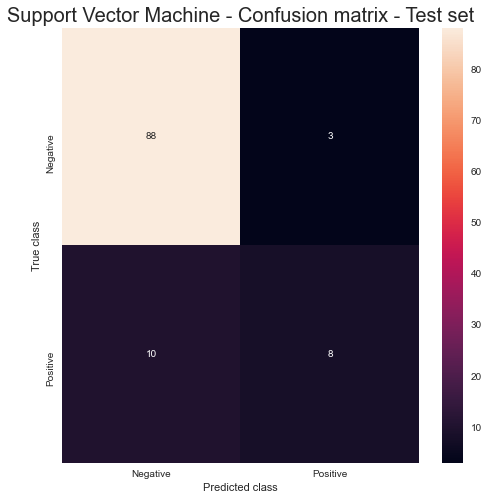

No Skill: ROC AUC=0.500
Support Vector Machine : ROC AUC=0.867


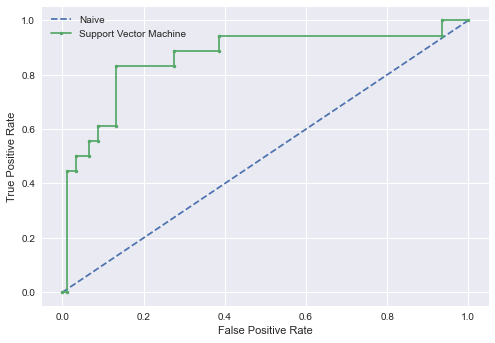

In [25]:
model_utils.evalute_model_performance(best_svm, 'Support Vector Machine',X_test_norm,y_test)


### Visualizing weights of the Logistic Regression

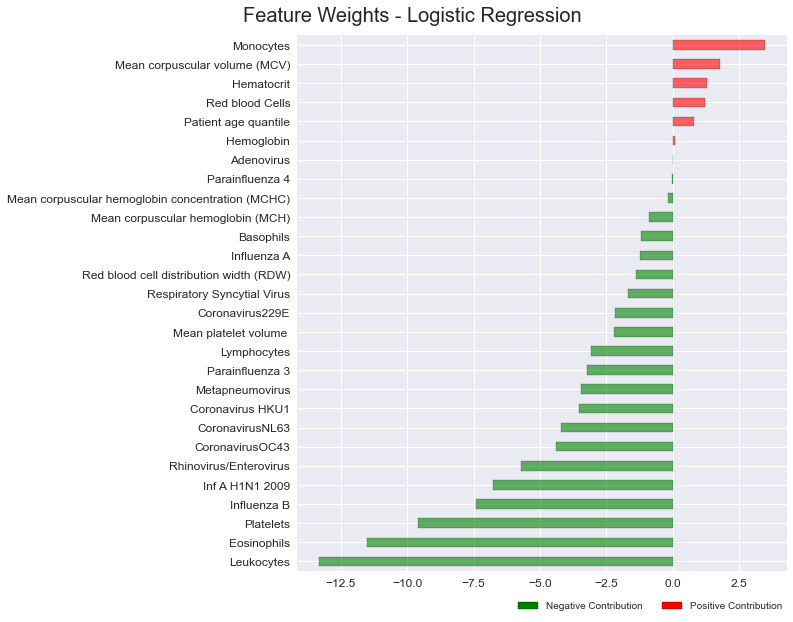

In [28]:
feature_importance_utils.show_feature_weights(columns_x,best_lr.coef_.ravel(),'Logistic Regression', color = ('r','g'), absolute_values = False)

## Visualizing Feature Weights from SVM and RandomForest with SHAP values

### Random Forest

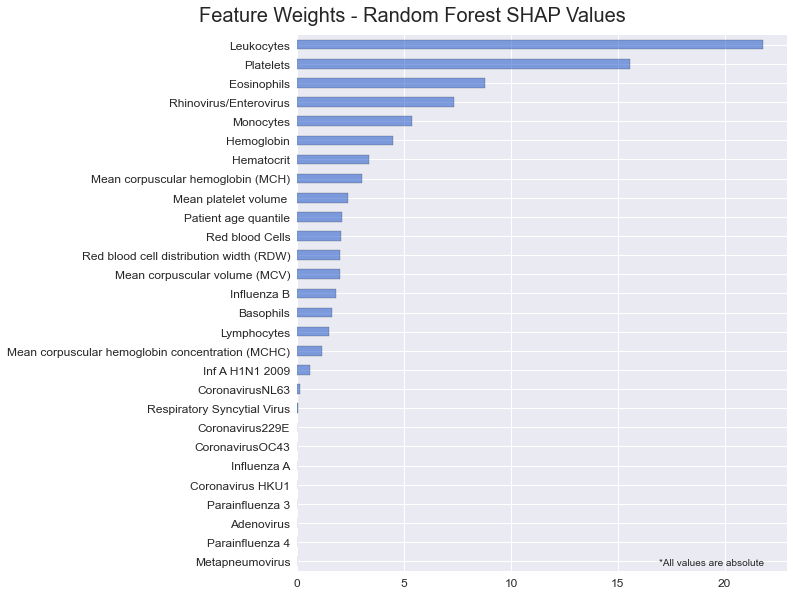

In [86]:
explainer_rf = shap.TreeExplainer(best_random_forest,X_train_norm)
shap_values_rf = explainer_rf.shap_values(X_train_norm,check_additivity=False)[0]
coef_rf = np.abs(shap_values_rf).sum(axis=0).ravel()

feature_importance_utils.show_feature_weights(columns_x,coef_rf,'Random Forest SHAP Values', absolute_values = True)

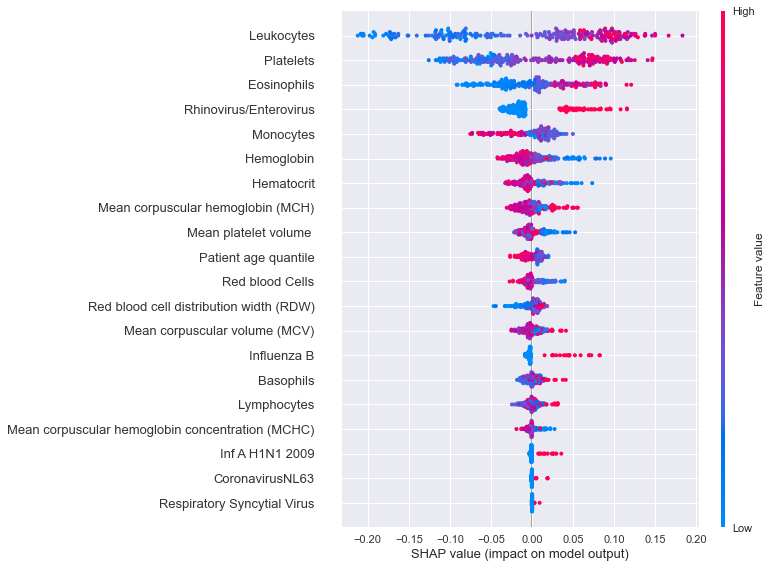

In [87]:
shap.summary_plot(shap_values_rf, X_train_norm)

In [97]:
# explainer_svm = shap.KernelExplainer(best_svm.predict_proba,X_train_norm,link="logit")

In [93]:
explainer_svm = shap.SamplingExplainer(best_svm.predict_proba,X_train_norm)

In [94]:
shap_values_svm = explainer_svm.shap_values(X_train_norm)[0]


100%|██████████| 253/253 [02:28<00:00,  1.71it/s]


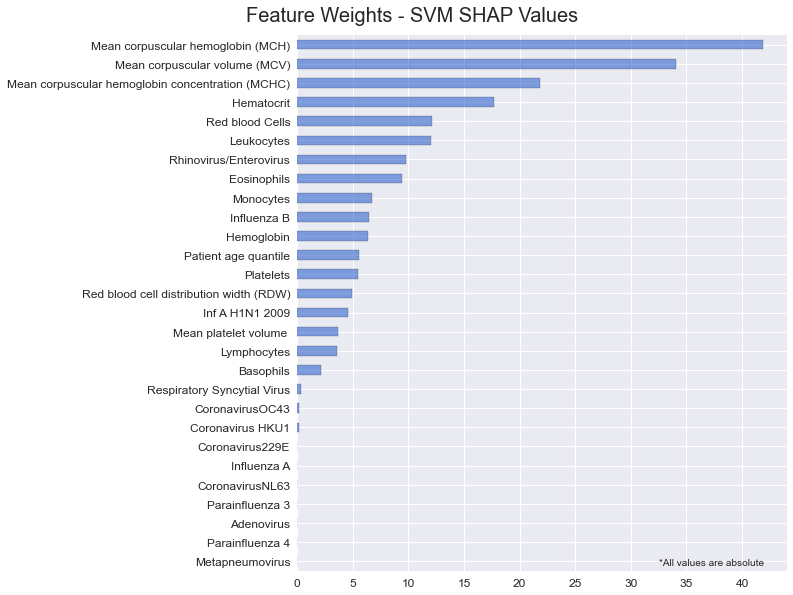

In [99]:
coef_svm = np.abs(shap_values_svm).sum(axis=0).ravel()

feature_importance_utils.show_feature_weights(columns_x,coef_svm,'SVM SHAP Values', absolute_values = True)

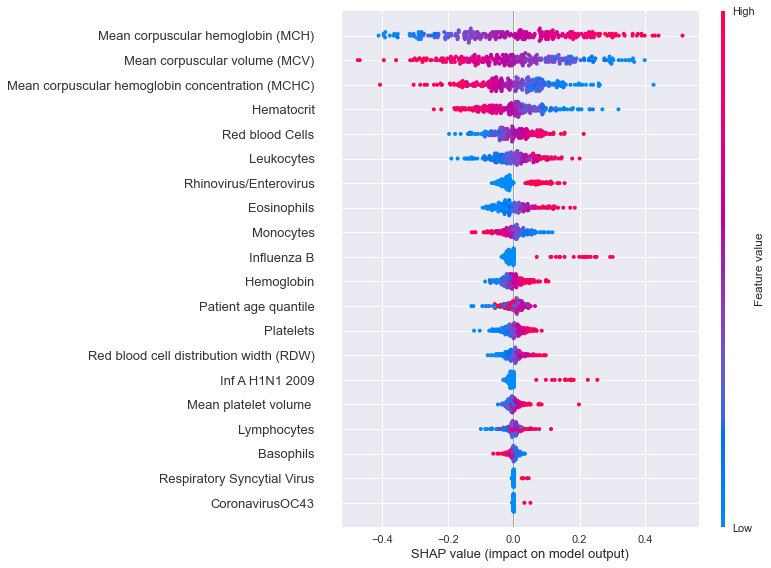

In [100]:
shap.summary_plot(shap_values_svm, X_train_norm)
